In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn

In [2]:
from pathlib import Path

In [3]:
plt.rcParams["figure.dpi"] = 200
plt.rcParams["figure.facecolor"] = "white"

# TODO
- ~Write/find harmony function~
- ~Write Rds saving function~
- ~Load up raw data for each population~
- ~Run pipeline for each subpopulation~
- ~Write cluster-reorder function~
- ~Write marker function~
- ~Write plot function~
- Generate clustering
- Generate marker lists
- Generate Rds file

In [4]:
from plotting.palettes import neuronal_palette

In [5]:
def quantile_limit(obj, key, q=0.99):
    obj = obj[key].copy()
    obj[obj > obj.quantile(0.99)] = obj.quantile(0.99)
    return obj

In [6]:
from rpy2.robjects import r, numpy2ri, globalenv,pandas2ri
numpy2ri.activate(); pandas2ri.activate()

r("""
library(harmony)
run_harmony <- function(pcs, metadata, cov, theta) {
    cov <- unlist(cov)
    theta <- unlist(theta)
    pcs.harmony <- HarmonyMatrix(
        pcs,
        metadata,
        vars_use=cov,
        theta=theta,
        do_pca=FALSE, 
        verbose=FALSE,
    )
    return(pcs.harmony)
}
""")
run_harmony = globalenv["run_harmony"]

r("""
save_rds <- function(log2cpm, tsne.data, featuredata, outfile) {
    colnames(log2cpm) <- gsub(".", "-", colnames(log2cpm), fixed = T)
    save(log2cpm, featuredata, tsne.data, file=outfile)
}
""")

def get_rds_embedding(adata, cluster_key="cluster", n_dims=3, embedding_type="umap"):
    if n_dims == 3:
        embedding = adata.obsm[f"X_{embedding_type}_3d"]
    else:
        embedding = adata.obsm[f"X_{embedding_type}"]
        embedding = np.column_stack((umap, np.zeros(umap.shape[0])))
    tsne_df = pd.DataFrame(embedding, columns=["V1", "V2", "V3"], index=adata.obs_names)
    tsne_df["dbCluster"] = adata.obs[cluster_key].astype(int)

    return tsne_df
def save_adata_to_rds(adata, outfile, cluster_key="cluster"):
    tmpd = sc.AnnData(np.asarray(adata.raw.X.todense()),
                           var=adata.raw.var, obs=adata.obs)

    sc.pp.normalize_total(tmpd, target_sum=None)
    sc.pp.log1p(tmpd)
    counts = pd.DataFrame(tmpd.X, columns=tmpd.var.gene_ids.values, index=tmpd.obs_names).T

    features = pd.DataFrame({"Associated.Gene.Name": tmpd.var.index, "Chromosome.Name": 1}, index=counts.index)

    counts.loc["ENSGGENES", :] = quantile_limit(adata.obs, "n_genes_by_counts")
    counts.loc["ENSGUMI", :] = quantile_limit(adata.obs, "total_counts")
    counts.loc["ENSGMITO", :] = quantile_limit(adata.obs, "pct_counts_mitochondrial")
    counts.loc["ENSGSEQSAT", :] = quantile_limit(adata.obs, "sequencing_saturation")
    if adata.uns.get("is_aggregation", None):
        counts.loc["ENSGSAMP", :] = adata.obs.batch.cat.codes
        features.loc["ENSGSAMP", :] = ["Sample", 1]

    features.loc["ENSGGENES", :] = ["Genes", 1]
    features.loc["ENSGUMI", :] = ["Umi", 1]
    features.loc["ENSGMITO", :] = ["PercentMito", 1]
    features.loc["ENSGSEQSAT", :] = ["Saturation", 1]

    umap = adata.obsm[f"X_umap"]
    embedding = np.column_stack((umap, np.zeros(umap.shape[0])))
    tsne_df = pd.DataFrame(embedding, columns=["V1", "V2", "V3"], index=adata.obs_names)
    tsne_df["dbCluster"] = adata.obs[cluster_key].astype(int)
    
    globalenv["save_rds"](counts, tsne_df, features, outfile)

R[write to console]: Loading required package: Rcpp



In [7]:
def subclustering_pipeline(adata_raw, theta=2, n_genes=1000, min_dist=0.5, neighbors=15):
    full = adata_raw.copy()
    sc.pp.normalize_total(full, target_sum=None)
    full.raw = full
    sc.pp.log1p(full)
    sc.pp.highly_variable_genes(full, n_top_genes=n_genes, flavor="cell_ranger")
    
    full.var.loc[
        full.var.mitochondrial |\
        full.var.hemoglobin |\
        full.var.ribosomal |\
        full.var_names.isin(["Fos", "Fosb", "Fosl1", "Fosl2", "Jun", "Junb", "Jund"]) |\
        full.var.sex_linked, 
        "highly_variable"
    ] = False

    sc.pp.pca(full, n_comps=50, svd_solver="arpack", use_highly_variable=True)
    full.obsm["X_pca_uncorrected"] = full.obsm["X_pca"].copy()
    full.varm["PCs_uncorrected"] = full.varm["PCs"].copy()
    full.uns["pca_uncorrected"] = full.uns["pca"].copy()
    
    emb = run_harmony(full.obsm["X_pca"], full.obs, ["chemistry", "sex"], [theta, 0.5])
    full.obsm["X_pca"] = emb
    sc.pp.neighbors(full, n_neighbors=neighbors, n_pcs=20, metric="correlation")
    sc.tl.umap(full, min_dist=min_dist)
    sc.tl.leiden(full, resolution=0.2)
    return full

In [8]:
def subset_raw(clusters, name, cluster_key="cluster_revised"):
    bcs = neuronal_final[neuronal_final.obs[cluster_key].isin(clusters)].obs_names
    subset = aggr[bcs, :].copy()
    
    outpath = Path("../data/").resolve().absolute()
    subset.obs["original_cluster"] = neuronal_final.obs.loc[bcs, cluster_key]
    subset.uns["output_dir"] = str(outpath)
    subset.uns["h5ad_dir"] = str(outpath / "h5ad")
    subset.uns["marker_dir"] = str(outpath / "markers")
    subset.uns["sampleid"] = f"aggr_{name}"
    
    sc.pp.filter_genes(subset, min_cells=3)
    sc.pp.filter_genes(subset, min_counts=3)
    return subset

In [9]:
def plot_side_by_side(original, subclust, orig_key="cluster_revised", sub_key="cluster", size=40):
    fig, axs = plt.subplots(1, 3, figsize=(14, 4), gridspec_kw={"wspace":0.5})

    groups = subclust.obs["original_cluster"].unique()
    orig_cats = original.obs[orig_key].cat.categories
    palette = [c for k, c in enumerate(neuronal_palette) if orig_cats[k] in groups]
    sc.pl.umap(
        original, groups=groups,
        color=orig_key, show=False, ax=axs[0], 
        palette=neuronal_palette
    )
    sc.pl.umap(
        subclust, 
        color="original_cluster", show=False, ax=axs[1],
        size=size,
        palette=palette
    )
    sc.pl.umap(subclust, color=sub_key, show=False, ax=axs[2], size=size)
    fig.subplots_adjust(left=0.04)
    return fig

In [5]:
from scipy.cluster.hierarchy import linkage, leaves_list
from scanpy.plotting._anndata import _prepare_dataframe
def reorder_clusters_hierarchical(adata, cluster_key, new_key="cluster", return_z=False):
    cats, tidy = _prepare_dataframe(
        adata,
        adata.var_names[adata.var.highly_variable],
        groupby=cluster_key,
        use_raw=False
    )
    mean_obs = tidy.groupby(level=0).mean()
    Z = linkage(mean_obs, method="ward", metric="euclidean", optimal_ordering=True)
    cluster_order = leaves_list(Z)

    new_clusters = (np.arange(len(cats)) + 1).astype(str)
    adata.obs[new_key] = adata.obs[cluster_key].map(
        dict(zip(cats[cluster_order], new_clusters))
    ).astype("category")
    adata.obs[new_key].cat.reorder_categories(new_clusters, inplace=True)

    if return_z:
        return adata, Z
    return adata

In [6]:
def report_in_out_group_fractions(
    adata: sc.AnnData,
    key=None,
    groupby=None,
    use_raw=True,
    log=True,
) -> None:
    if key is None:
        key = 'rank_genes_groups'

    if groupby is None:
        groupby = str(adata.uns[key]['params']['groupby'])

    gene_names = pd.DataFrame(adata.uns[key]['names'])

    fraction_in_cluster_matrix = pd.DataFrame(
        np.zeros(gene_names.shape),
        columns=gene_names.columns,
        index=gene_names.index,
    )
    fraction_out_cluster_matrix = pd.DataFrame(
        np.zeros(gene_names.shape),
        columns=gene_names.columns,
        index=gene_names.index,
    )
    for cluster in gene_names.columns:
        var_names = gene_names[cluster].values
        adata.obs['__is_in_cluster__'] = pd.Categorical(adata.obs[groupby] == cluster)

        categories, obs_tidy = _prepare_dataframe(
            adata,
            var_names,
            groupby='__is_in_cluster__',
            use_raw=use_raw,
        )

        mean_obs = obs_tidy.groupby(level=0).mean()
        obs_bool = obs_tidy.astype(bool)
        fraction_obs = obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
        fraction_in_cluster_matrix.loc[:, cluster] = fraction_obs.loc[True].values
        fraction_out_cluster_matrix.loc[:, cluster] = fraction_obs.loc[False].values

    adata.obs.drop(columns='__is_in_cluster__')

    return fraction_in_cluster_matrix, fraction_out_cluster_matrix

_helper_outer = lambda df, name: pd.melt(
    df, value_name=name, var_name="cluster"
).set_index("cluster")
_helper = lambda adata, col, name: _helper_outer(
    pd.DataFrame.from_records(adata.uns["rank_genes_groups"][col]), name
)

def compute_marker_genes(adata, groupby="cluster", use_raw=True, method="wilcoxon", suffix="", save=True):
    sc.tl.rank_genes_groups(adata, groupby="cluster", use_raw=True, method="wilcoxon", n_genes=250)
    in_groups, out_groups = report_in_out_group_fractions(adata, groupby="cluster")

    sizes = adata.obs.groupby("cluster").size()

    markers = pd.concat(
        (
            _helper(adata, "names", "gene"),
            _helper(adata, "scores", "score"),
            _helper(adata, "logfoldchanges", "logfc"),
            _helper(adata, "pvals", "pval"),
            _helper(adata, "pvals_adj", "pval_fdr"),
            _helper_outer(in_groups, "in_group_fraction"),
            _helper_outer(out_groups, "out_group_fraction"),
            _helper_outer(out_groups < 0.2, "specific_20%"),
            _helper_outer(out_groups < 0.05, "specific_5%"),
            _helper_outer(out_groups < 0.01, "specific_1%")
        ),
        axis=1
    )
    markers["n_cells"] = sizes.loc[markers.index]

    # remove ribosomal genes
    markers = markers.loc[~markers.gene.str.match("^M?rp[ls]"), :]

    if save:
        suffix = f"-{suffix}" if suffix else ""
        outpath = Path("../data") / "markers" / f"{adata.uns['sampleid']}{suffix}.csv"
        markers.to_csv(outpath, index=True, header=True)
    else:
        return markers

In [7]:
from sklearn import metrics
from scipy.stats import wilcoxon
def logmean(x, axis=0):
    return np.log1p(np.mean(x, axis=axis))

def logmeanexp(x, axis=0):
    return np.log1p(np.mean(np.expm1(x), axis=axis))

def xflatten(x):
    return np.asarray(x).flatten()
def find_marker_genes(adata, cluster_key="cluster", log_fold_change=1.0):
    clusters = adata.obs[cluster_key].cat.categories

    auc_scores = []
    for cluster in clusters:
        print(cluster, end=" ")
        inds = adata.obs[cluster_key] == cluster

        group = adata.raw[inds, :]
        rest = adata.raw[~inds, :]

        group_mean = xflatten(logmean(group.X, axis=0))
        rest_mean = xflatten(logmean(rest.X, axis=0))
        diff = abs(group_mean - rest_mean)
        gene_inds = np.where(diff > log_fold_change)[0]

        truth = inds.astype(int).values
        scores = []
        for gene_ind in gene_inds:
            pred = xflatten(adata.raw.X[:, gene_ind].todense())
            scores.append(metrics.roc_auc_score(truth, pred))

        tmp = pd.DataFrame({
            "AUROC": scores,
            "gene_name": adata.raw.var_names[gene_inds],
            "avg_diff": diff[gene_inds],
            f"{cluster_key}": np.repeat([cluster], len(scores))
        })
        tmp = tmp.sort_values("AUROC", ascending=False)

        auc_scores.append(tmp)

    markers = pd.concat(auc_scores)
    markers = markers.reindex(columns=["gene_name", "AUROC", "avg_diff", cluster_key])
    markers = markers.reset_index(drop=True)
    #adata.uns["auroc_markers"] = markers.to_records(index=False)
    # recarrays with different dtypes don't play nice with h5 reading/writing
    # instead lets try just a column-based key:list dictionary
    adata.uns["auroc_markers"] = markers.to_dict(orient="list")

    return markers

## Subclusterings

- 17 + 13?  (Hdc+ TMNv + TMNd?)
- 20 (LM)
- 7 + 9? + 10? (pMN)
- 15 + 19 (
- 1--5 (MM)
- 11 + 12 + 13? + 14?

In [8]:
aggr = sc.read("../../final_analysis/aggr_output_ver5/posterior_hypothalamus_aggr-aggr_20190821.h5ad")
neuronal_final = sc.read("../data/h5ad/neuronal-final.h5ad")

/opt/conda/lib/python3.7/site-packages/anndata/compat/__init__.py:161: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/anndata/compat/__init__.py:161: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  FutureWarning,


## SUM

In [9]:
sum_final = sc.read("../data/h5ad/glut8-subclustering.h5ad")
sum_final.obs["cluster"] = sum_final.obs["cluster_revised"].copy()
sum_final.uns["sampleid"] = "aggr_sum"
#sum_final.uns["cluster_colors"] = sum_final.uns["cluster_revised_colors"].copy()

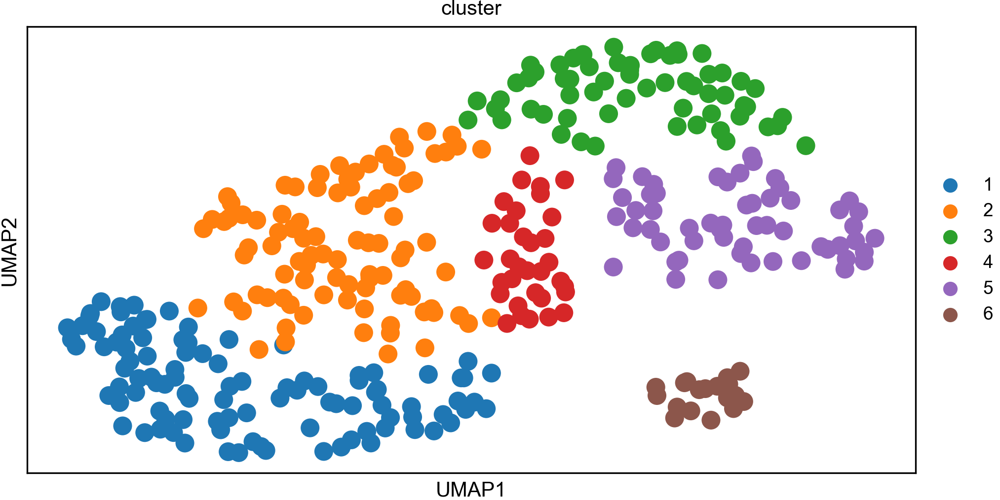

In [23]:
sc.pl.umap(sum_final, color="cluster")

In [10]:
sum_markers = compute_marker_genes(sum_final, save=False)

In [15]:
from plotting.plot_funcs import marker_violins

In [60]:
violin_genes = ["Slc32a1", "Slc17a6"]
for cluster in sum_final.obs.cluster.cat.categories:
    _tmp = sum_markers[sum_markers.index == cluster]
    _topk = _tmp.head(3).gene
    _spec = _tmp[_tmp["specific_20%"]].head(5).gene
    _g = pd.Index(_topk).union(pd.Index(_spec))
    violin_genes += _g[~_g.duplicated()].tolist()
violin_genes = pd.Index(violin_genes)
violin_genes = violin_genes[~violin_genes.duplicated()].tolist()
violin_genes = list(filter(lambda s: not s.endswith("Rik"), violin_genes))

Saved to sum_marker_violins-v2.pdf


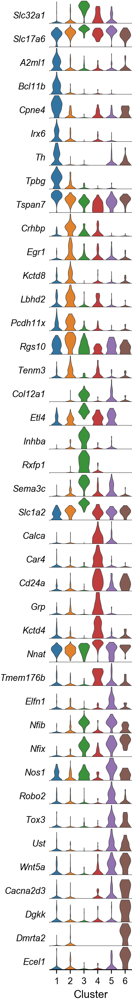

In [62]:
marker_violins(
    sum_final, violin_genes[:41], "cluster", sum_final.uns["cluster_colors"],
    figdir="sum_markers", filename="sum_marker_violins-v2"
)

## TMN

In [329]:
tmn_raw = subset_raw(["13", "17"], "tmn_like")
tmn = subclustering_pipeline(tmn_raw)

/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:121: FutureWarning: This location for 'distances' is deprecated. It has been moved to .obsp[distances], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['distances'] = neighbors.distances
/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:122: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'] = neighbors.connectivities
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_umap.py:147: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'].tocoo(),
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for

In [330]:
sc.tl.leiden(tmn, resolution=0.6)
sc.tl.leiden(tmn, resolution=0.1, restrict_to=("leiden", ["3"]))

/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']


In [331]:
tmn_final = reorder_clusters_hierarchical(tmn, "leiden_R")

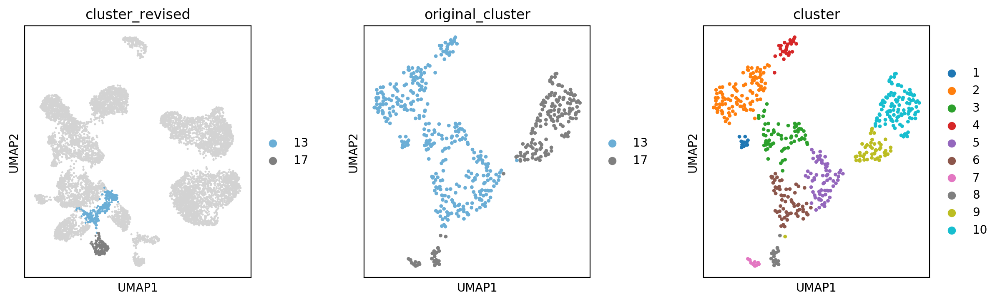

In [332]:
plot_side_by_side(neuronal_final, tmn_final, sub_key="cluster", size=40)

In [333]:
tmn_markers = compute_marker_genes(tmn_final, save=True)

In [334]:
tmn_markers_old = find_marker_genes(tmn_final, log_fold_change=0.5)

1 2 3 4 5 6 7 8 9 10 

## LM

In [335]:
lm_raw = subset_raw(["20"], "lm")
lm = subclustering_pipeline(lm_raw, theta=1, n_genes=500)

/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:121: FutureWarning: This location for 'distances' is deprecated. It has been moved to .obsp[distances], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['distances'] = neighbors.distances
/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:122: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'] = neighbors.connectivities
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_umap.py:147: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'].tocoo(),
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for

In [337]:
lm_final = reorder_clusters_hierarchical(lm, "leiden")

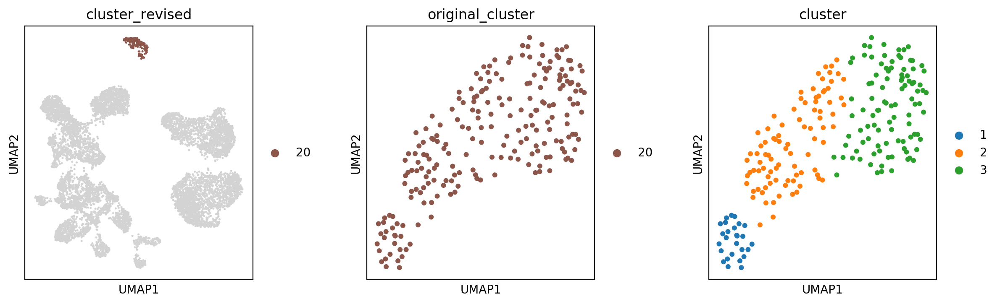

In [343]:
plot_side_by_side(neuronal_final, lm_final, size=75)

In [344]:
lm_markers = compute_marker_genes(lm_final, save=True)

In [345]:
lm_markers_old = find_marker_genes(lm_final, log_fold_change=0.5)

1 2 3 

## PMN

In [360]:
pmn_raw = subset_raw(["7"], "pmn")
pmn = subclustering_pipeline(pmn_raw, min_dist=1)

/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:121: FutureWarning: This location for 'distances' is deprecated. It has been moved to .obsp[distances], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['distances'] = neighbors.distances
/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:122: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'] = neighbors.connectivities
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_umap.py:147: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'].tocoo(),
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for

In [361]:
sc.tl.leiden(pmn, resolution=0.4)

/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']


In [362]:
pmn9_raw = subset_raw(["7", "9", "10"], "pmn-extra")
pmn9 = subclustering_pipeline(pmn9_raw, min_dist=1)

/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:121: FutureWarning: This location for 'distances' is deprecated. It has been moved to .obsp[distances], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['distances'] = neighbors.distances
/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:122: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'] = neighbors.connectivities
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_umap.py:147: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'].tocoo(),
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for

In [365]:
sc.tl.leiden(pmn9, resolution=0.4)

/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']


In [367]:
pmn_final = reorder_clusters_hierarchical(pmn, "leiden")
pmn9_final = reorder_clusters_hierarchical(pmn9, "leiden")

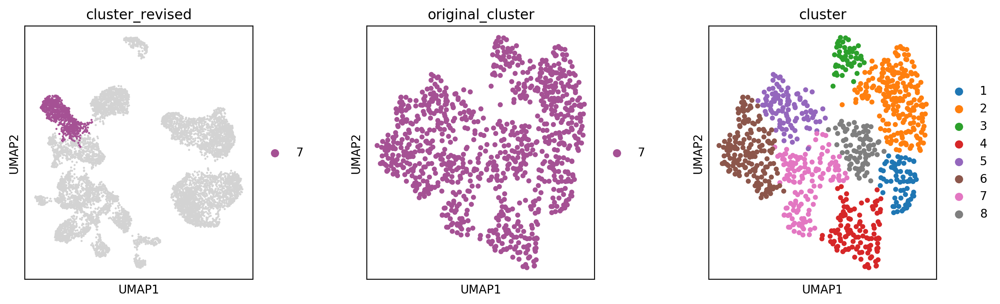

In [368]:
plot_side_by_side(neuronal_final, pmn_final, size=75)

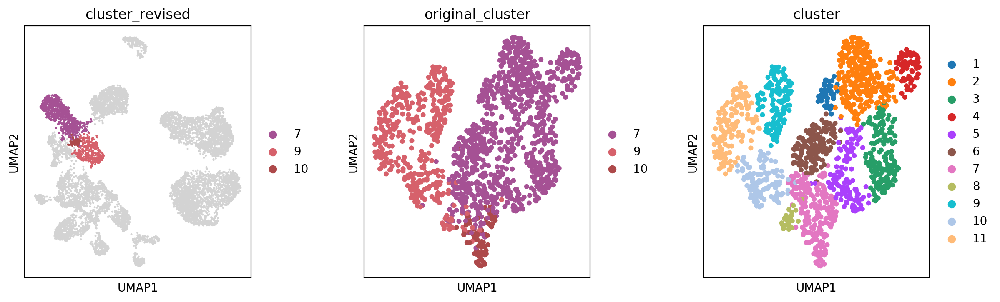

In [369]:
plot_side_by_side(neuronal_final, pmn9_final, size=75)

In [373]:
pmn_markers = compute_marker_genes(pmn_final, save=True)
pmn_markers_old = find_marker_genes(pmn_final, log_fold_change=0.5)
pmn9_markers = compute_marker_genes(pmn9_final, save=True)
pmn9_markers_old = find_marker_genes(pmn9_final, log_fold_change=0.5)

1 2 3 4 5 6 7 8 1 2 3 4 5 6 7 8 9 10 11 

## ARC

In [472]:
arc_raw = subset_raw(["14", "16", "18"], "arc")
arc = subclustering_pipeline(arc_raw, min_dist=1)

/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:121: FutureWarning: This location for 'distances' is deprecated. It has been moved to .obsp[distances], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['distances'] = neighbors.distances
/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:122: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'] = neighbors.connectivities
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_umap.py:147: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'].tocoo(),
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for

In [479]:
sc.tl.leiden(arc, resolution=0.5)

/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']


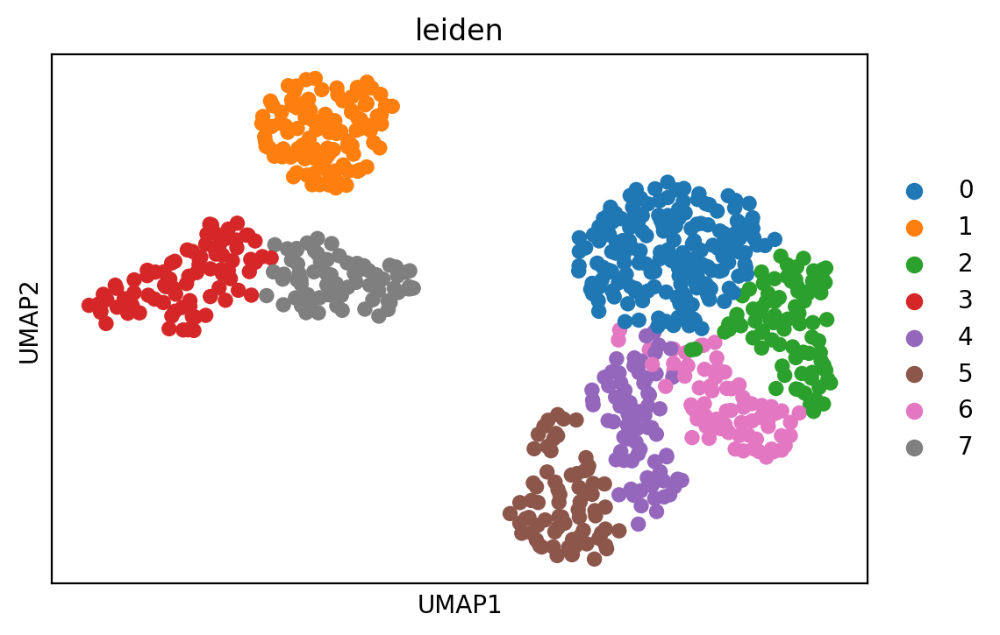

In [480]:
sc.pl.umap(arc, color="leiden")

In [481]:
arc_final = reorder_clusters_hierarchical(arc, "leiden")

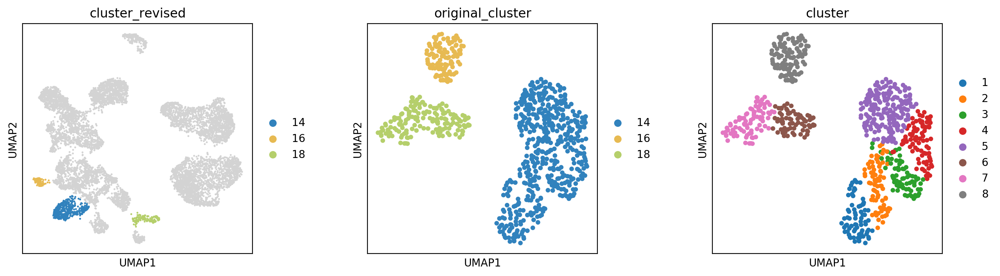

In [483]:
plot_side_by_side(neuronal_final, arc_final, size=75);

In [484]:
arc_markers = compute_marker_genes(arc_final, save=True)
arc_markers_old = find_marker_genes(arc_final, log_fold_change=0.5)

1 2 3 4 5 6 7 8 

## LHA

In [501]:
lha_raw = subset_raw(["15", "19"], "lha")
lha = subclustering_pipeline(lha_raw, min_dist=1)
sc.tl.leiden(lha, resolution=0.4)

/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:121: FutureWarning: This location for 'distances' is deprecated. It has been moved to .obsp[distances], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['distances'] = neighbors.distances
/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:122: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'] = neighbors.connectivities
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_umap.py:147: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'].tocoo(),
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for

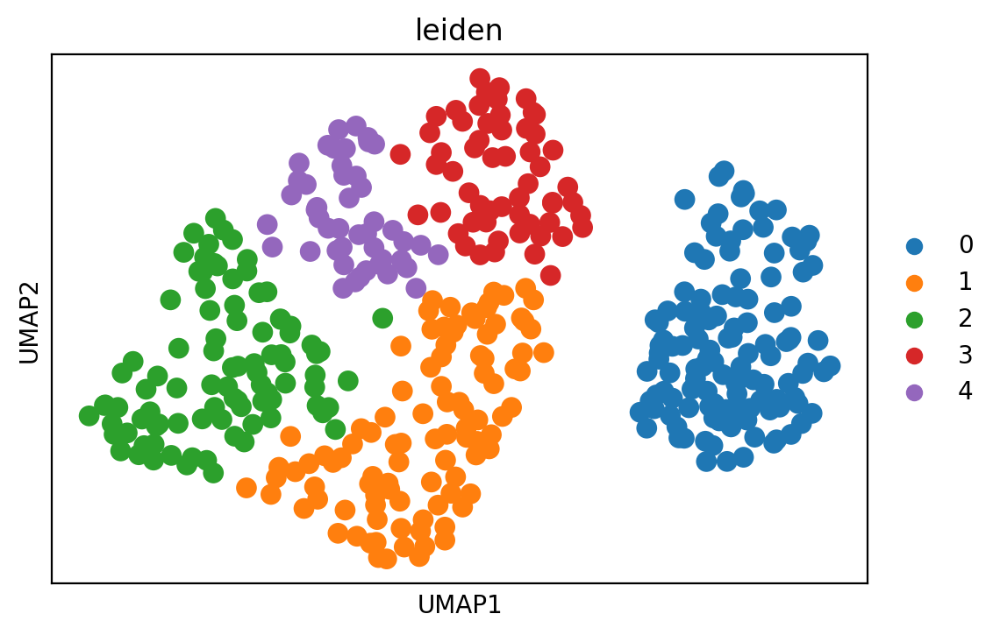

In [502]:
sc.pl.umap(lha, color="leiden")

In [503]:
lha_final = reorder_clusters_hierarchical(lha, "leiden")

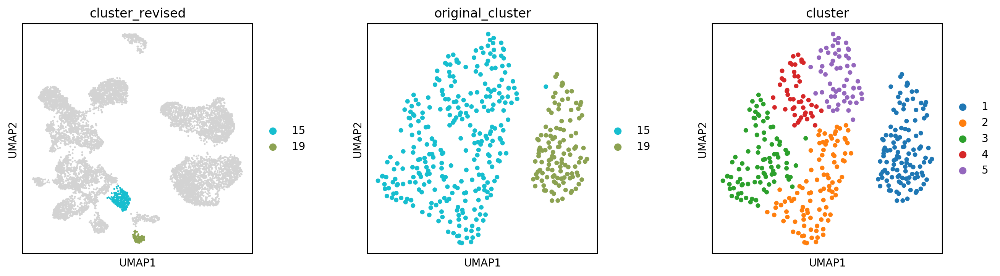

In [504]:
plot_side_by_side(neuronal_final, lha_final, size=75);

In [505]:
lha_markers = compute_marker_genes(lha_final, save=True)
lha_markers_old = find_marker_genes(lha_final, log_fold_change=0.5)

1 2 3 4 5 

## MM

In [401]:
mm_raw = subset_raw(list("12345"), "mm")
mm = subclustering_pipeline(mm_raw, min_dist=0.5)

/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:121: FutureWarning: This location for 'distances' is deprecated. It has been moved to .obsp[distances], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['distances'] = neighbors.distances
/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:122: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'] = neighbors.connectivities
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_umap.py:147: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'].tocoo(),
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for

In [418]:
sc.tl.leiden(mm, resolution=0.8)
sc.tl.leiden(mm, resolution=0.1, restrict_to=("leiden", ("10", )))

/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']


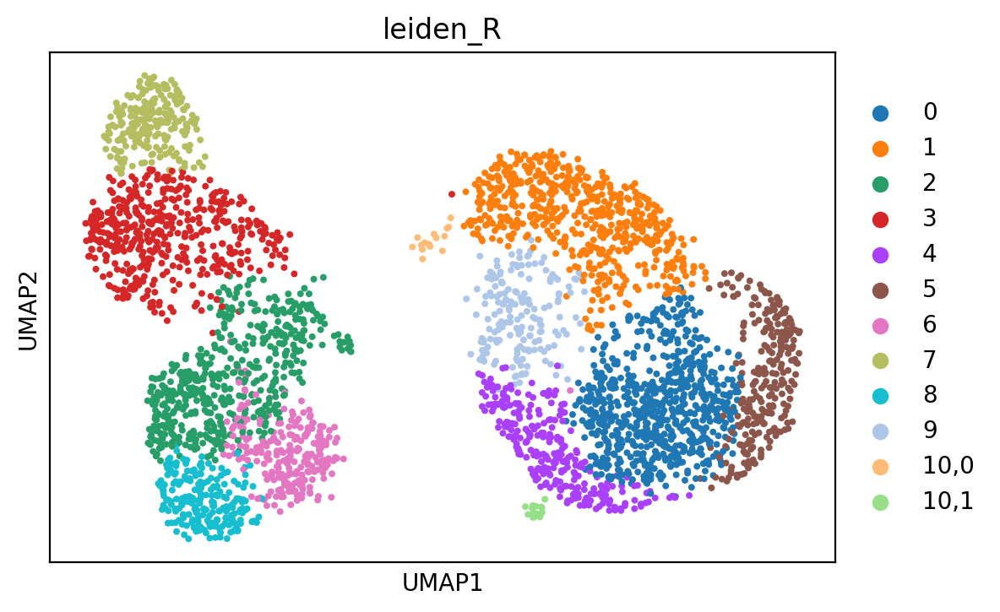

In [419]:
sc.pl.umap(mm, color="leiden_R")

In [421]:
mm_final = reorder_clusters_hierarchical(mm, "leiden_R")

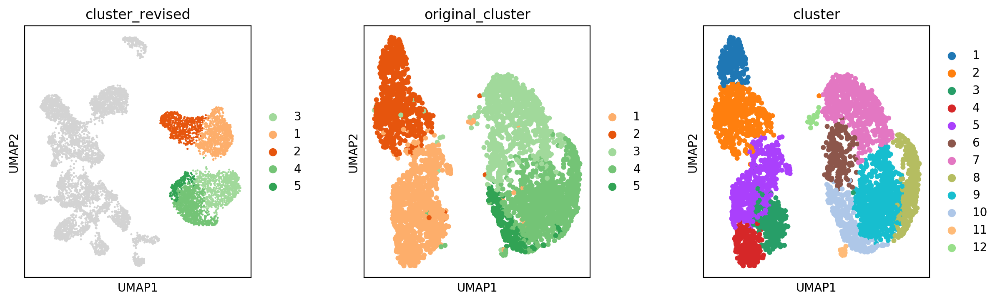

In [422]:
plot_side_by_side(neuronal_final, mm_final, size=75)

In [424]:
mm_markers = compute_marker_genes(mm_final, save=True)
mm_markers_old = find_marker_genes(mm_final, log_fold_change=0.5)

1 2 3 4 5 6 7 8 9 10 11 12 

## Unknowns

In [431]:
unknown_raw = subset_raw(["11", "12", "13", "14"], "unknowns")
unknown = subclustering_pipeline(unknown_raw, min_dist=0.9)

/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:121: FutureWarning: This location for 'distances' is deprecated. It has been moved to .obsp[distances], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['distances'] = neighbors.distances
/opt/conda/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:122: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'] = neighbors.connectivities
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_umap.py:147: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adata.uns['neighbors']['connectivities'].tocoo(),
/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for

In [439]:
sc.tl.leiden(unknown, resolution=0.8)

/opt/conda/lib/python3.7/site-packages/scanpy/tools/_leiden.py:111: FutureWarning: This location for 'connectivities' is deprecated. It has been moved to .obsp[connectivities], and will not be accesible here in a future version of anndata.
  adjacency = adata.uns['neighbors']['connectivities']


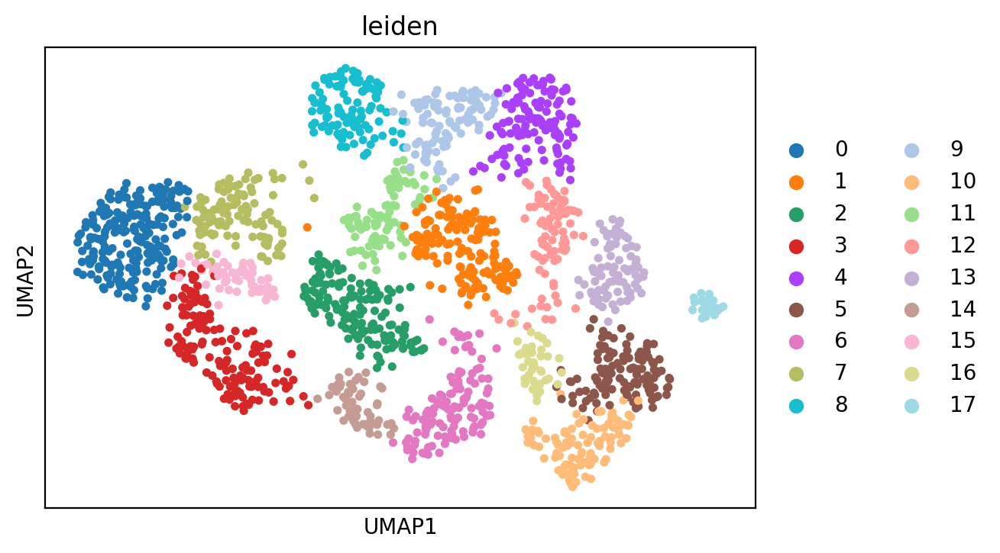

In [440]:
sc.pl.umap(unknown, color="leiden")

In [441]:
unknown_final = reorder_clusters_hierarchical(unknown, "leiden")

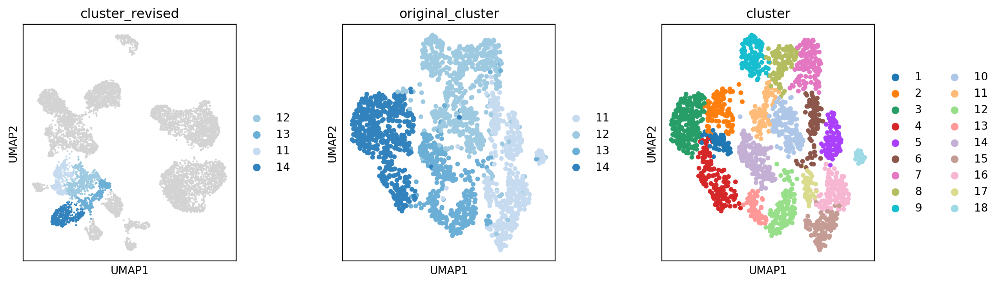

In [442]:
plot_side_by_side(neuronal_final, unknown_final, size=75)

In [443]:
unknown_markers = compute_marker_genes(unknown_final, save=True)
unknown_markers_old = find_marker_genes(unknown_final, log_fold_change=0.5)

1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 

## Save H5AD files

In [446]:
for ad in (
    tmn_final, lm_final,
    pmn_final, pmn9_final,
    arc_final,
    mm_final,
    unknown_final,
):
    sc.write(f"../data/h5ad/{ad.uns['sampleid']}.h5ad", ad)

## Save Old-style markers

In [67]:
import os
def get_marker_dataframe(adata, marker_key="auroc_markers"):
    return pd.DataFrame.from_dict(adata.uns[marker_key])
def export_markers(adata, cluster_key, marker_key="auroc_markers"):
    excelname = f"{adata.uns['sampleid']}_old-style.xlsx"
    excelfile = os.path.join(adata.uns["marker_dir"], excelname)

    csvname = f"{adata.uns['sampleid']}_old-style.csv"
    csvfile = os.path.join(adata.uns["marker_dir"], csvname)

    #markers = pd.DataFrame.from_records(adata.uns["auroc_markers"])
    markers = get_marker_dataframe(adata, marker_key)
    markers[cluster_key] = markers[cluster_key].astype(int)

    markers.to_csv(csvfile)
    with pd.ExcelWriter(excelfile) as writer:
        for cluster in markers[cluster_key].unique():
            inds = markers[cluster_key] == cluster
            name = f"Cluster {cluster}"
            markers.loc[inds].to_excel(writer, name)
        writer.save()

In [461]:
for ad in (
    tmn_final, lm_final,
    pmn_final, pmn9_final,
    arc_final, lha_final,
    mm_final,
    unknown_final,
):
    export_markers(ad, "cluster")

In [ ]:
# fix ARC and LHA
export_markers(lha_final, )

## Save Rds for Alex

In [463]:
for ad in (
    tmn_final, lm_final,
    pmn_final, pmn9_final,
    arc_final,
    mm_final,
    unknown_final,
):
    save_adata_to_rds(ad, f"../data/rds/{ad.uns['sampleid']}.rds")

/opt/conda/lib/python3.7/site-packages/rpy2/robjects/pandas2ri.py:63: UserWarning: Error while trying to convert the column "Associated.Gene.Name". Fall back to string conversion. The error is: module 'pandas' has no attribute 'NA'
  % (name, str(e)))
/opt/conda/lib/python3.7/site-packages/rpy2/robjects/pandas2ri.py:63: UserWarning: Error while trying to convert the column "Associated.Gene.Name". Fall back to string conversion. The error is: module 'pandas' has no attribute 'NA'
  % (name, str(e)))
/opt/conda/lib/python3.7/site-packages/rpy2/robjects/pandas2ri.py:63: UserWarning: Error while trying to convert the column "Associated.Gene.Name". Fall back to string conversion. The error is: module 'pandas' has no attribute 'NA'
  % (name, str(e)))
/opt/conda/lib/python3.7/site-packages/rpy2/robjects/pandas2ri.py:63: UserWarning: Error while trying to convert the column "Associated.Gene.Name". Fall back to string conversion. The error is: module 'pandas' has no attribute 'NA'
  % (name, s

## Save figures

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:9: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  if __name__ == '__main__':
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:9: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  if __name__ == '__main__':
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:9: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  if __name__ == '__main__':
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:9: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  if __name__ == '__main__':
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:9: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.

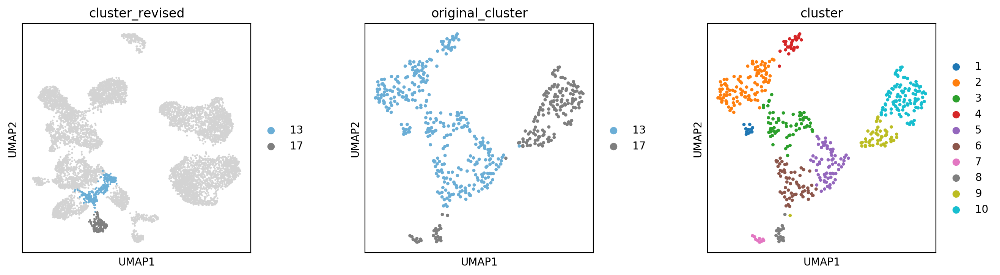

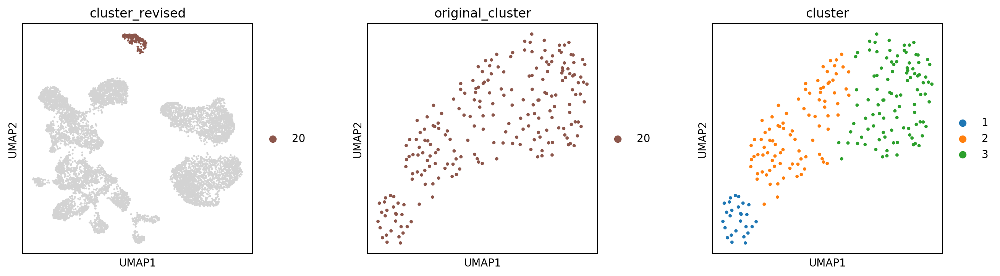

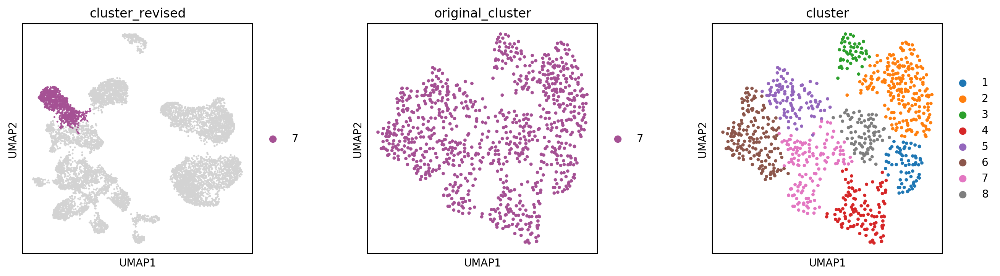

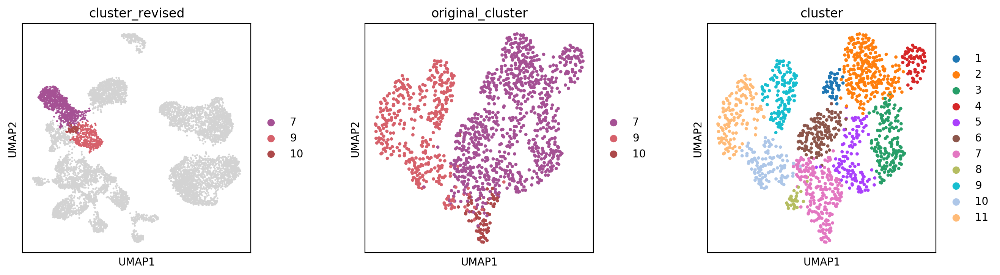

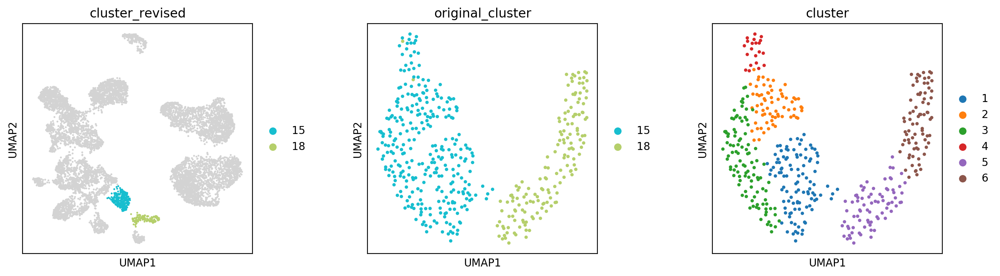

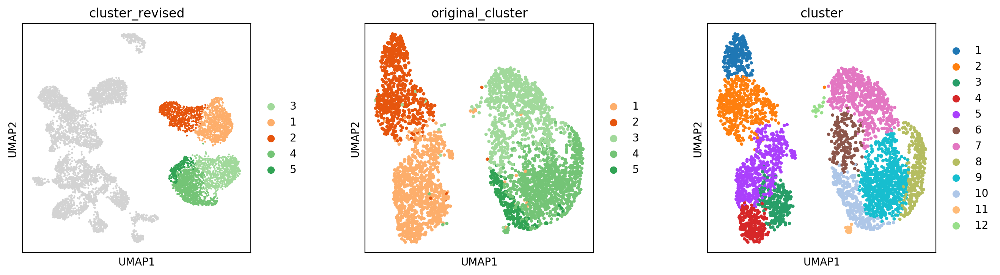

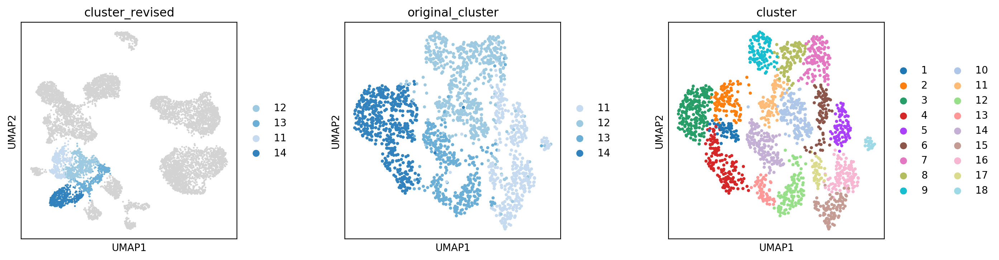

In [468]:
for ad in (
    tmn_final, lm_final,
    pmn_final, pmn9_final,
    arc_final,
    mm_final,
    unknown_final,
):
    fig = plot_side_by_side(neuronal_final, ad)
    fig.tight_layout()
    fig.savefig(f"../figures/revision/{ad.uns['sampleid']}_subclustering-prelim.pdf")

### Deeper looks

In [155]:
tmn_final = sc.read("../data/h5ad/aggr_tmn_like.h5ad")
lm_final = sc.read("../data/h5ad/aggr_lm.h5ad")
pmn_final = sc.read("../data/h5ad/aggr_pmn.h5ad")
pmn9_final = sc.read("../data/h5ad/aggr_pmn-extra.h5ad")
arc_final = sc.read("../data/h5ad/aggr_arc.h5ad")
lha_final = sc.read("../data/h5ad/aggr_lha.h5ad")
mm_final = sc.read("../data/h5ad/aggr_mm.h5ad")
unknown_final = sc.read("../data/h5ad/aggr_unknowns.h5ad")

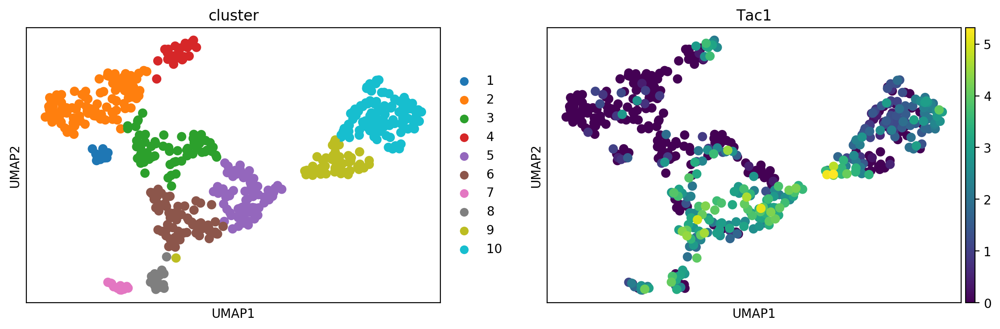

In [14]:
sc.pl.umap(tmn_final, color=["cluster", "Tac1"], use_raw=False)

In [41]:
t = np.column_stack((neuronal_final[tmn_final.obs_names,:].obsm["X_umap"], np.arange(len(tmn_final))))

In [46]:
ts = np.array(sorted(t, key=lambda k: (k[1],k[0])))[:, -1].astype(int)

In [50]:
tmn_final.obs["number"] = 0
tmn_final.obs["number"].iloc[ts] = np.arange(len(tmn_final))

/opt/conda/lib/python3.7/site-packages/pandas/core/indexing.py:189: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)


In [51]:
neuronal_final.obs["number"] = np.inf
neuronal_final.obs.loc[tmn_final.obs_names, "number"] = tmn_final.obs["number"]

In [54]:
tmn_final.obs["orig_x"] = neuronal_final[tmn_final.obs_names,:].obsm["X_umap"][:,0]
tmn_final.obs["orig_y"] = neuronal_final[tmn_final.obs_names,:].obsm["X_umap"][:,1]

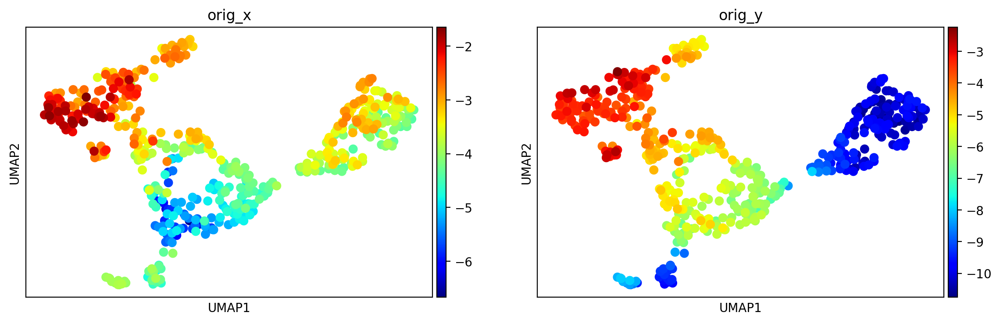

In [57]:
sc.pl.umap(tmn_final, color=["orig_x", "orig_y"], cmap="jet")

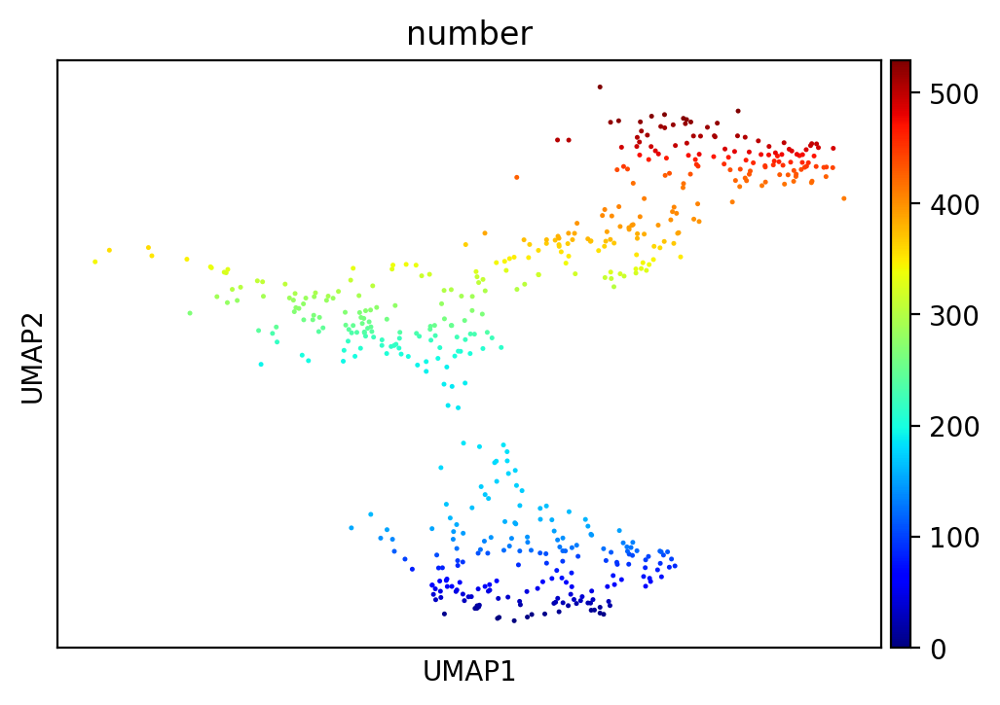

In [53]:
sc.pl.umap(neuronal_final, color="number", cmap="jet")

In [58]:
from plotting.plot_funcs import marker_violins

In [75]:
tmn_markers = pd.read_csv("../data/markers/aggr_tmn_like.csv")

In [83]:
tmn_markers.columns

Index(['cluster', 'gene', 'score', 'logfc', 'pval', 'pval_fdr',
       'in_group_fraction', 'out_group_fraction', 'specific_20%',
       'specific_5%', 'specific_1%', 'n_cells'],
      dtype='object')

In [135]:
def get_genes_from_markers(marker_list, n=6):
    ms = []
    for cluster, df in marker_list.groupby("cluster"):
        topn = df.head(n//2)
        spec = df[df["specific_20%"]].head(n//2)
        ms += pd.concat((topn, spec)).sort_values("logfc", ascending=False).gene.values.tolist()
    ms = pd.Index(ms)
    return ms[~ms.duplicated()]

Saved to aggr_tmn_like_violins-v1.pdf
Saved to aggr_lm_violins-v1.pdf
Saved to aggr_pmn_violins-v1.pdf
Saved to aggr_pmn-extra_violins-v1.pdf
Saved to aggr_arc_violins-v1.pdf
Saved to aggr_lha_violins-v1.pdf
Saved to aggr_mm_violins-v1.pdf
Saved to aggr_unknowns_violins-v1.pdf


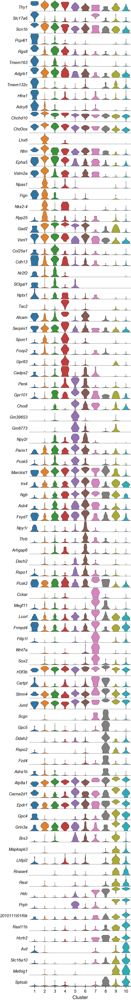

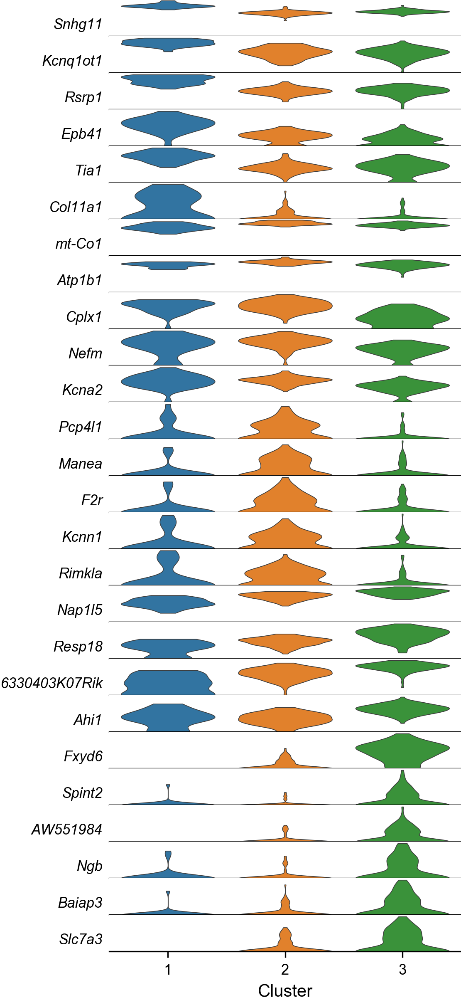

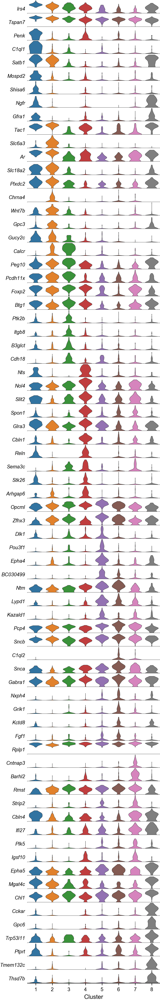

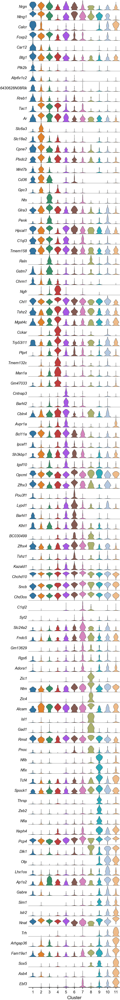

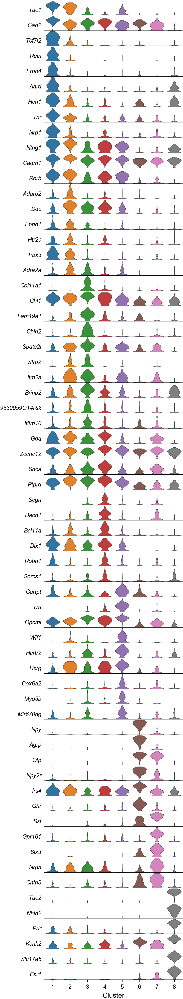

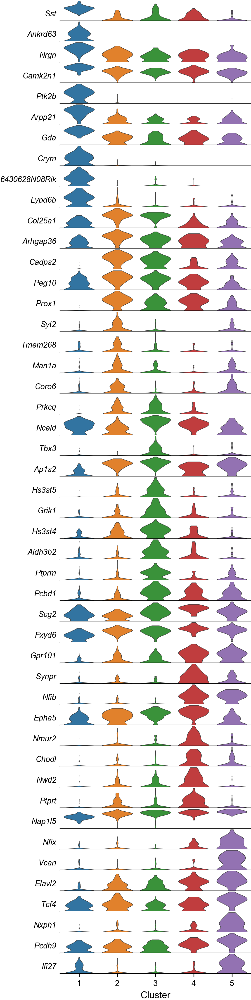

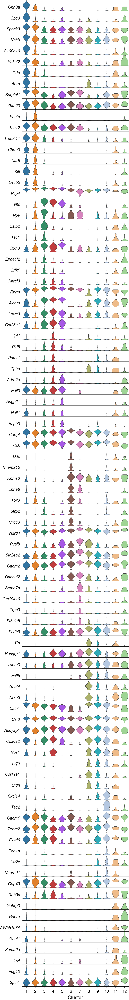

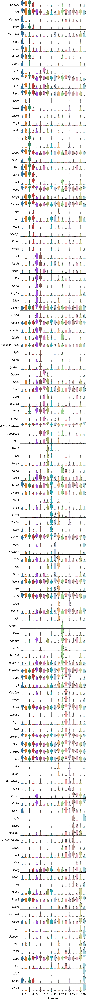

In [161]:
for ad in (
    tmn_final, lm_final,
    pmn_final, pmn9_final,
    arc_final, lha_final,
    mm_final,
    unknown_final,
):
    markers = pd.read_csv(f"../data/markers/{ad.uns['sampleid']}.csv")
    genes = get_genes_from_markers(markers, n=10)
    fname = f"{ad.uns['sampleid']}_violins-v1"
    palette = ad.uns["cluster_colors"]
    marker_violins(ad, genes, "cluster", palette, filename=fname, figdir=Path("revision"))

## Heatmaps

In [164]:
from plotting.plot_funcs import get_heatmap_data, fix_heatmap_annotations, fix_heatmap_colorbar, heatmap_cmap

In [187]:
from utils.load_data import save_figure

In [244]:
def plot_heatmap(adata, name, cluster_key="cluster"):
    markers = get_marker_dataframe(adata)
    markers.AUROC += 0.15
    
    n_clusters = len(adata.obs[cluster_key].cat.categories)
    palette = adata.uns[f"{cluster_key}_colors"]
    #palette, k = ("tab10", 10) if n_clusters <= 10 else ("tab20", 20)
    #palette = seaborn.mpl_palette(palette, k)

    heatmap_data, col_colors, row_colors = get_heatmap_data(
        adata, markers, cluster_key, palette
    )
    
    cg = seaborn.clustermap(
        heatmap_data, z_score=0, vmin=-3, vmax=3, cmap=heatmap_cmap,
        xticklabels=False, yticklabels=False, row_cluster=False, col_cluster=False,
        row_colors=row_colors, col_colors=col_colors,
        robust=True, figsize=(4, 4),
        cbar_kws=dict(use_gridspec=True)
    )
    cg.ax_row_colors.set_ylabel("Genes", size="small")
    cg.ax_col_colors.set_title(f"{name} - Cells", size="small", zorder=100)
    fix_heatmap_colorbar(cg, adata, heatmap_data, heatmap_cmap)

    cg.ax_col_colors.xaxis.tick_top()
    fix_heatmap_annotations(cg)
    cg.fig.subplots_adjust(bottom=0.1)
    save_heatmap(cg, "revision", f"{adata.uns['sampleid']}_heatmap-v1", dpi=600, ext="png")
    return cg

In [209]:
Path(".").parent.parent

PosixPath('.')

In [235]:
from pathlib import Path
from datetime import datetime

CURRENT_DATE = datetime.now().strftime("%Y%m%d")
FIG_PATH = Path("..") / "figures" / CURRENT_DATE

def save_heatmap(cg, pdir, name, dpi=600, ext="pdf"):
    if not FIG_PATH.exists():
        FIG_PATH.mkdir(parents=True)

    out = FIG_PATH / pdir / f"{name}.{ext}"
    pout = FIG_PATH / pdir
    if not pout.exists():
        pout.mkdir()
    
    cg.savefig(out, dpi=dpi)
    print(f"Saved to {out.name}")


In [211]:
adatas = tmn_final, lm_final, pmn_final, pmn9_final, arc_final, lha_final, mm_final, unknown_final
names = "TMN", "LM", "PMNv", "PMNv+", "ARC", "LHA", "MM", "GLUT11-GABA12-GABA13"

Saved to aggr_tmn_like_heatmap-v1.png
Saved to aggr_lm_heatmap-v1.png
Saved to aggr_pmn_heatmap-v1.png
Saved to aggr_pmn-extra_heatmap-v1.png
Saved to aggr_arc_heatmap-v1.png
Saved to aggr_lha_heatmap-v1.png
Saved to aggr_mm_heatmap-v1.png
Saved to aggr_unknowns_heatmap-v1.png


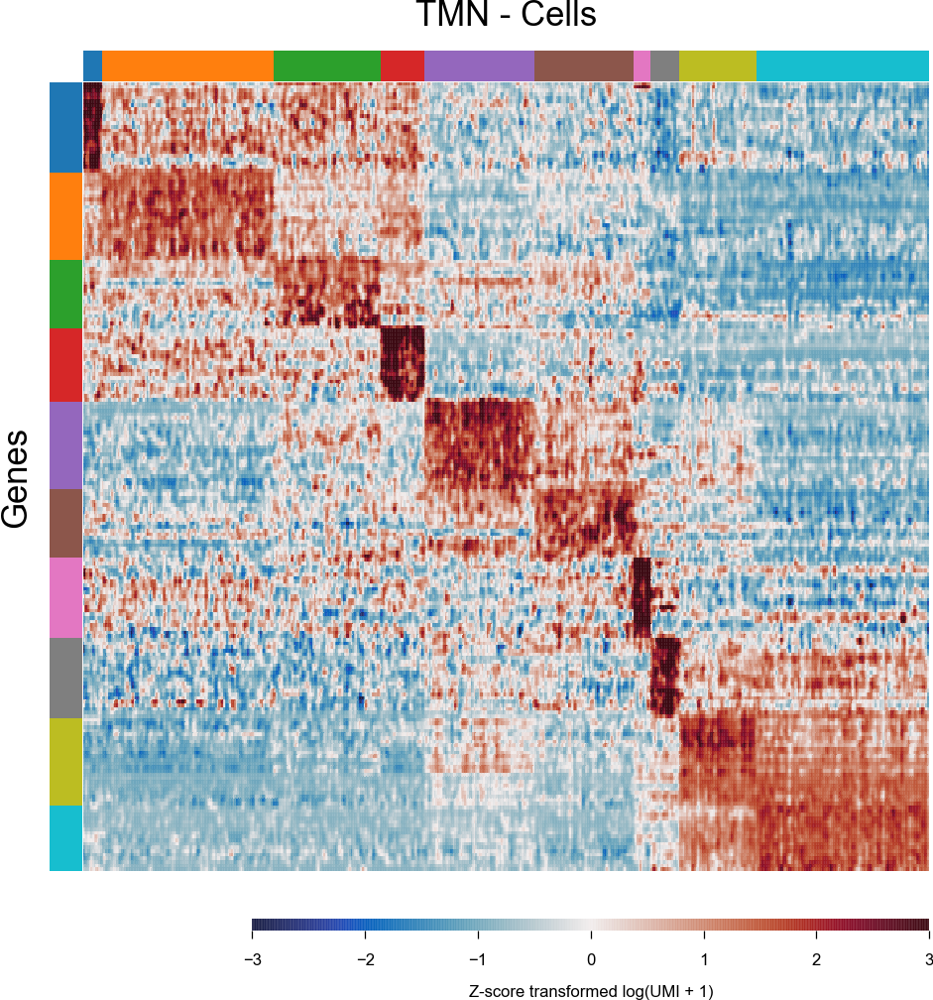

<Figure size 30x30 with 0 Axes>

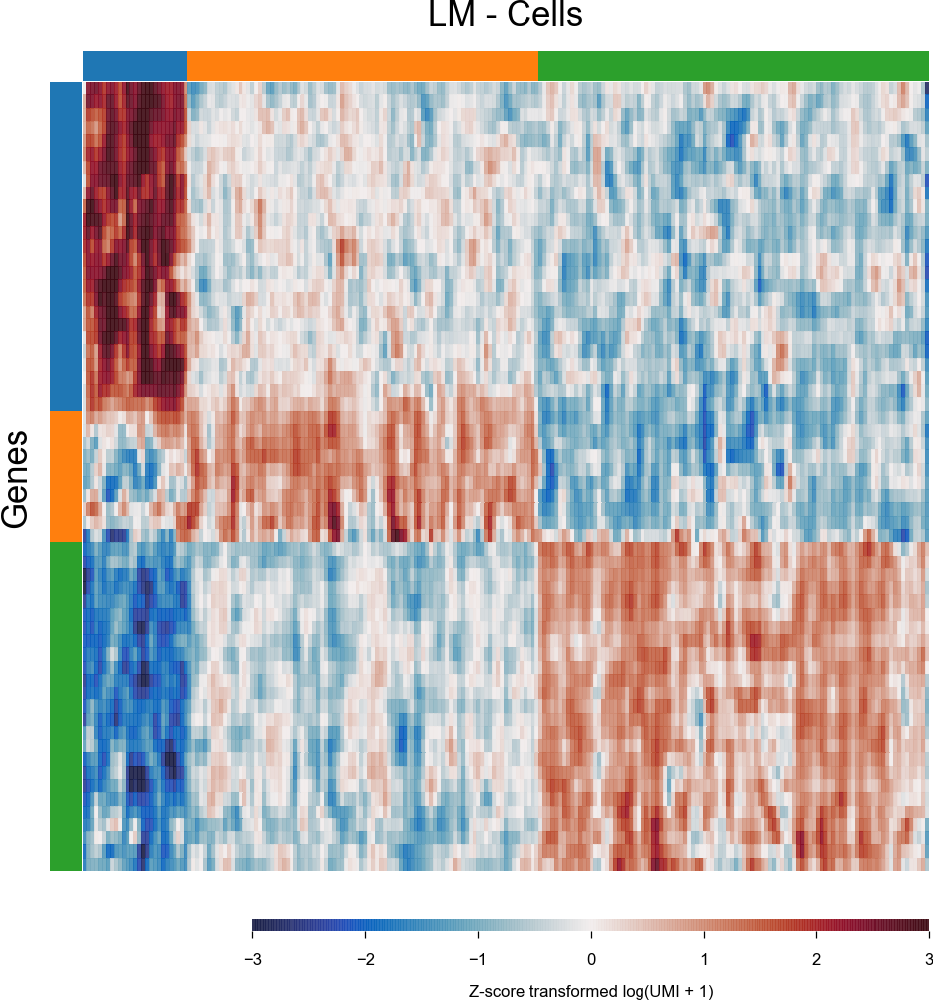

<Figure size 30x30 with 0 Axes>

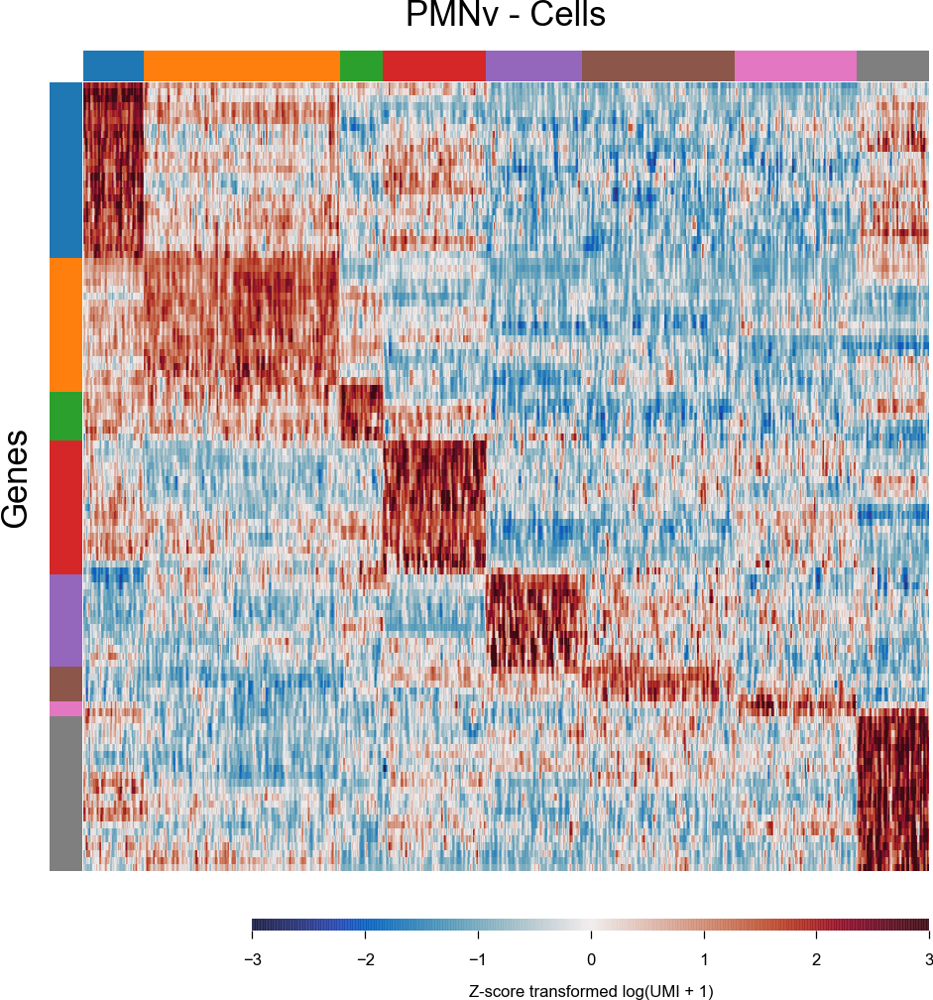

<Figure size 30x30 with 0 Axes>

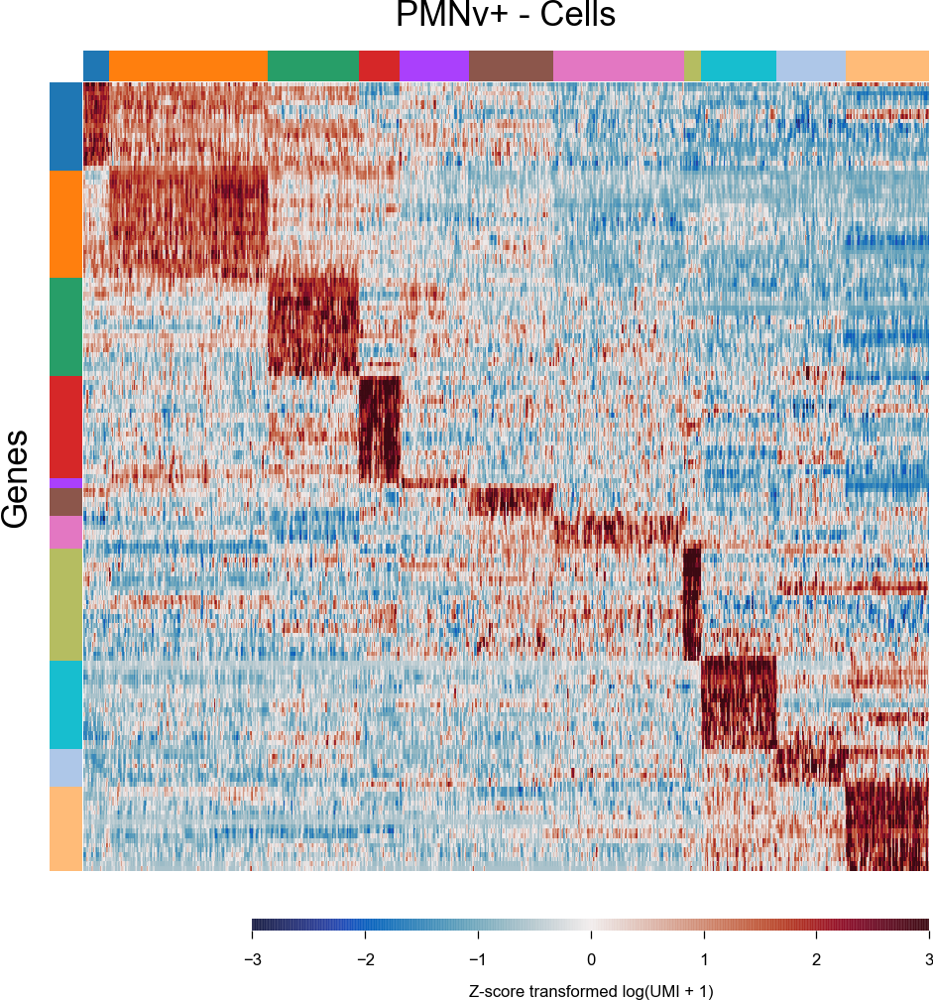

<Figure size 30x30 with 0 Axes>

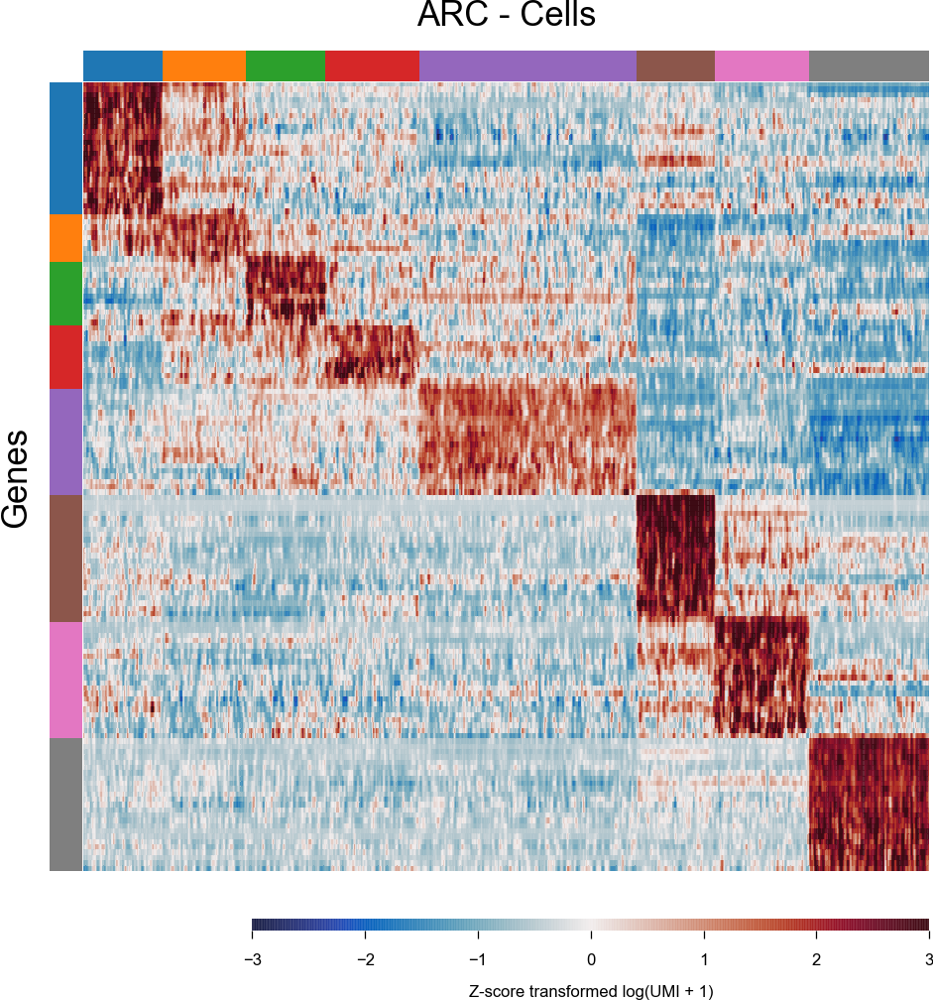

<Figure size 30x30 with 0 Axes>

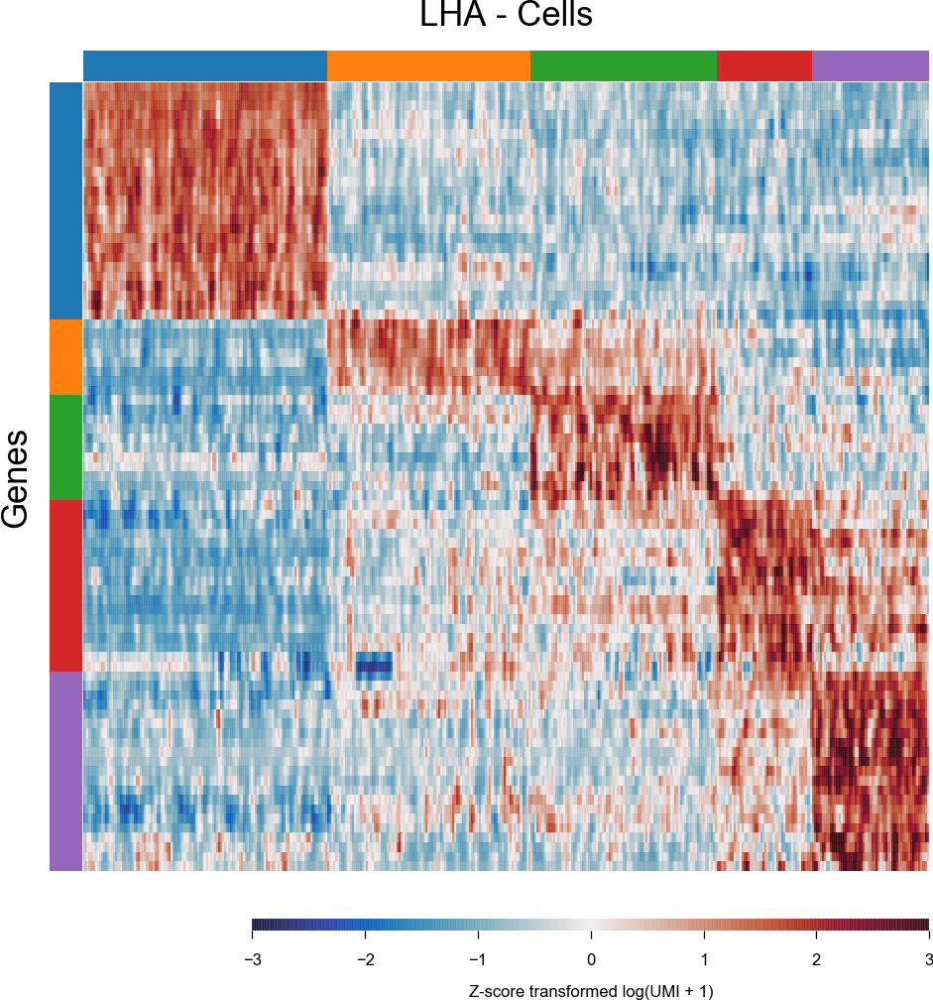

<Figure size 30x30 with 0 Axes>

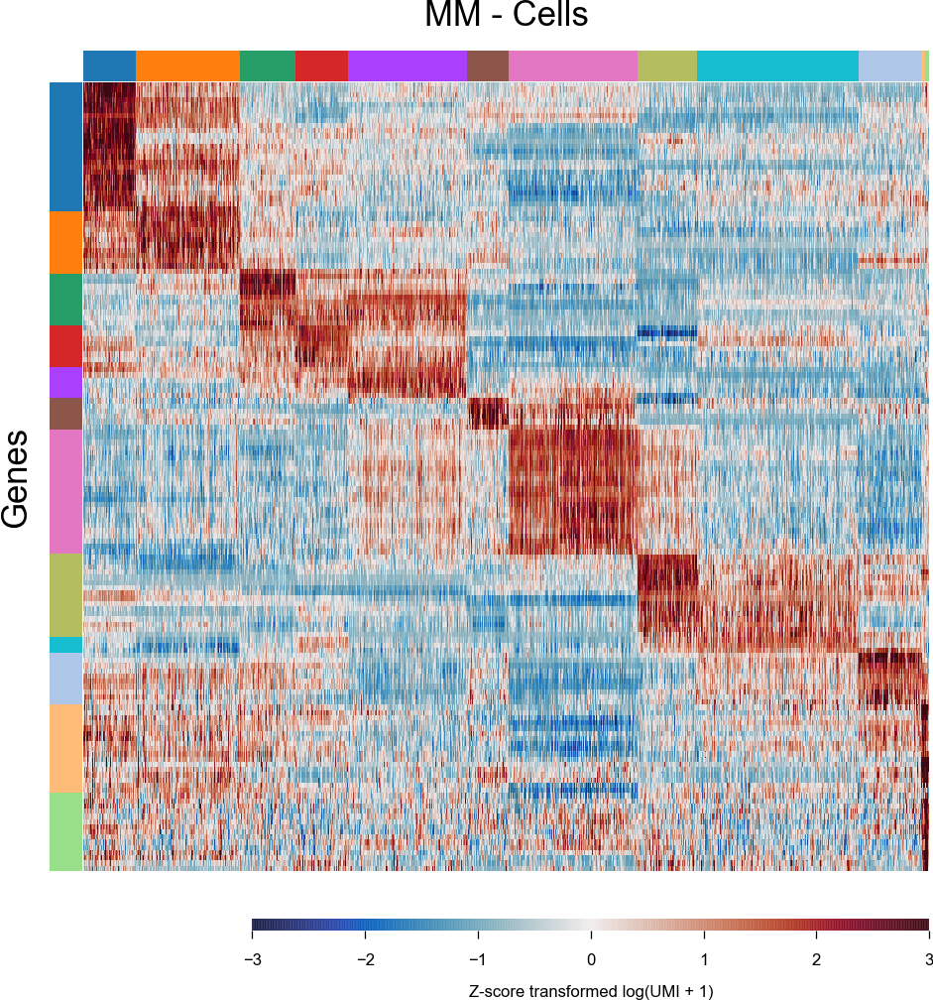

<Figure size 30x30 with 0 Axes>

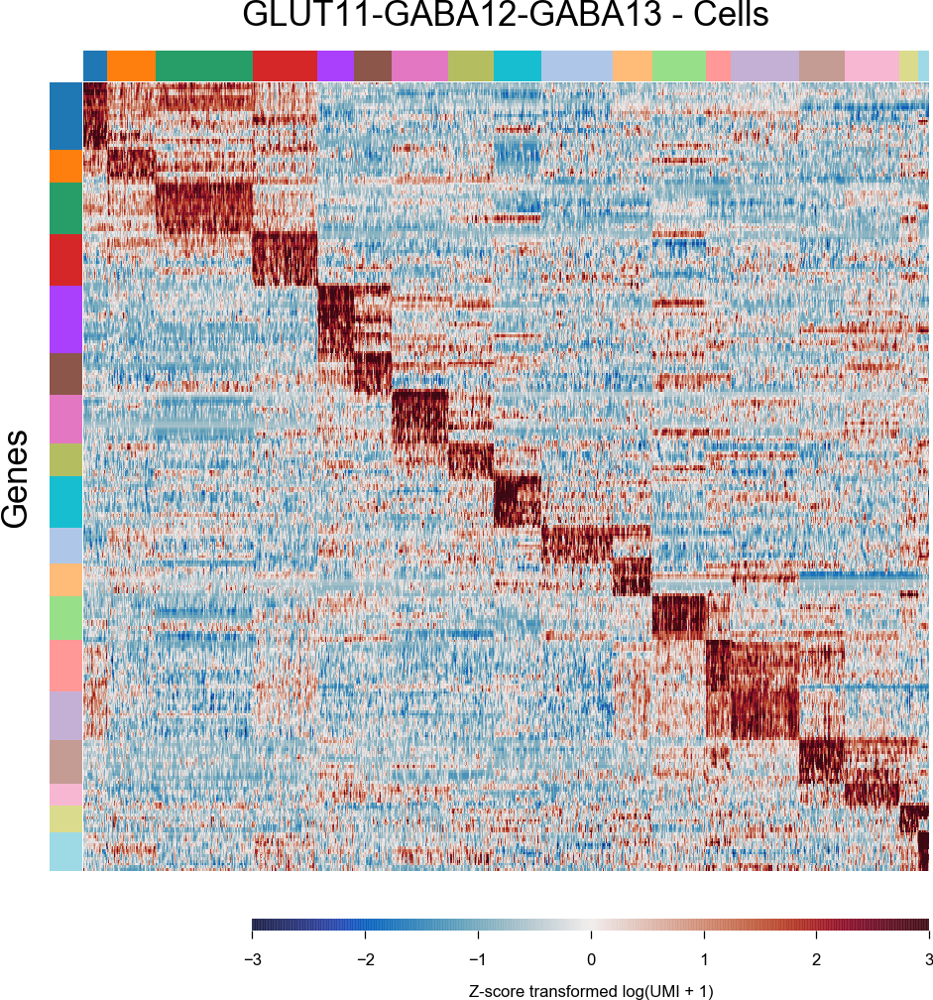

<Figure size 30x30 with 0 Axes>

In [245]:
for ad, name in zip(adatas, names):
    c = plot_heatmap(ad, name)